In [1]:
import pandas as pd
import pyarrow

easy_data = pd.read_parquet("../data/super_easy/track2_data.parquet")
hard_data = pd.read_parquet("../data/hard/track2_data.parquet")
easy_move = pd.read_parquet("../data/super_easy/ground_truth.parquet")
hard_move = pd.read_parquet("../data/hard/ground_truth.parquet")

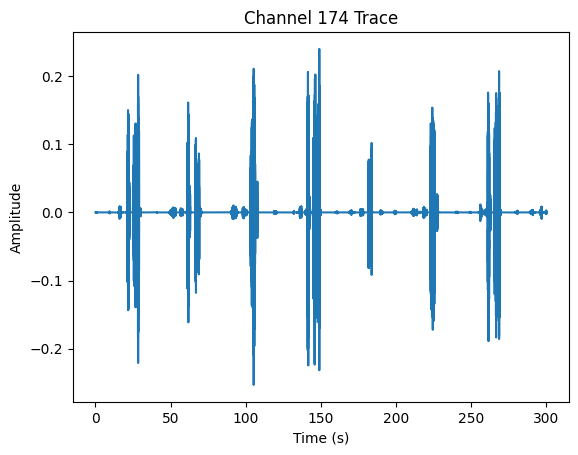

In [2]:
import matplotlib.pyplot as plt

# Replace 'data' with your actual variable name (e.g., easy_data or hard_data)
# This uses the 'time_s' index automatically for the x-axis
easy_data[174].plot(title="Channel 174 Trace", xlabel="Time (s)", ylabel="Amplitude")
plt.show()

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def plot_spatial_power(df, t_start=None, t_end=None):
    """
    Generates a 32x32 colormap of signal power (RMS) for a specific time interval.
    
    Parameters:
    - df: Input DataFrame (index must be time_s, columns 0-1023)
    - t_start: Start time in seconds (default: beginning of file)
    - t_end: End time in seconds (default: end of file)
    """
    # 1. Slice the dataframe (defaults to full df if times are None)
    subset = df.loc[t_start:t_end]
    
    if subset.empty:
        print("Error: No data found in the specified time range.")
        return

    # 2. Calculate Power (RMS) for each channel
    # RMS = sqrt(mean(x^2))
    # Note: If you strictly want 'Area Under Curve of rectified signal', use .abs().sum()
    power_values = np.sqrt((subset ** 2).mean())
    
    # 3. Reshape into 32x32 grid
    # Data is ordered row-major (Ch 0-31 = Row 0, Ch 32-63 = Row 1, etc.)
    grid_map = power_values.values.reshape(32, 32)
    
    # 4. Plot
    plt.figure(figsize=(10, 8))
    plt.imshow(grid_map, cmap='viridis', aspect='auto')
    plt.colorbar(label='RMS Amplitude')
    
    # Labeling context
    title_time = f" ({t_start if t_start else 'Start'}s - {t_end if t_end else 'End'}s)"
    plt.title(f"Spatial Signal Power{title_time}")
    plt.xlabel("Column (0-31)")
    plt.ylabel("Row (0-31)")
    plt.show()

# Example Usage:
# plot_spatial_power(easy_data)                  # Whole file
# plot_spatial_power(hard_data, t_start=10, t_end=15) # 5 second window

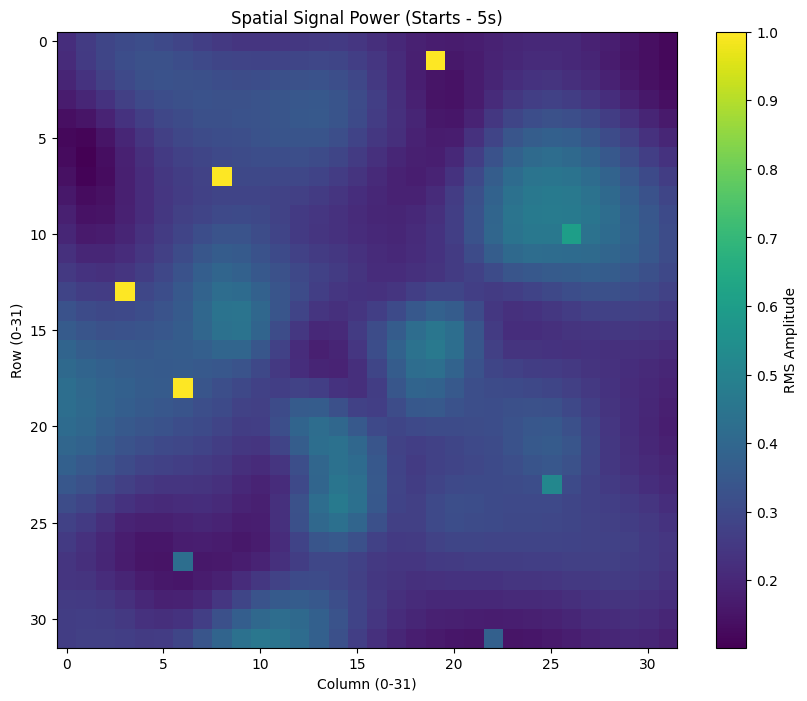

In [14]:
plot_spatial_power(easy_data, t_start=0, t_end=5)

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def animate_spatial_power(df, t_start, t_end, window_size=1.0, fps=20):
    """
    Animates the 32x32 RMS power map.
    
    Parameters:
    - window_size: "one sec for one frame" -> 1.0s integration window.
    - fps: Frames per second (defines the slide step size).
    """
    
    # 1. Setup Time Steps
    # We step forward by 1/FPS seconds so the video plays in real-time speed.
    dt = 1 / fps  
    time_steps = np.arange(t_start, t_end - window_size, dt)
    
    # 2. Pre-calculate global min/max for consistent colorbar
    # (Optional but recommended so colors don't flicker)
    print("Calculating global limits for stable colors...")
    subset = df.loc[t_start:t_end]
    # Estimate range from a quick coarse check or full stats
    global_max = np.sqrt((subset**2).mean()).max() * 1.2
    global_min = 0 

    # 3. Setup the Plot
    fig, ax = plt.subplots(figsize=(8, 8))
    
    # Initialize with the first frame
    first_window = df.loc[t_start : t_start + window_size]
    power_vals = np.sqrt((first_window ** 2).mean()).values.reshape(32, 32)
    
    im = ax.imshow(power_vals, cmap='viridis', aspect='auto', 
                   vmin=global_min, vmax=global_max)
    plt.colorbar(im, label='RMS Amplitude')
    
    title_text = ax.set_title(f"Time: {t_start:.2f}s - {t_start+window_size:.2f}s")
    ax.set_xlabel("Column (0-31)")
    ax.set_ylabel("Row (0-31)")

    # 4. Update Function for Animation
    def update(t):
        # Slice: t to t + 1s
        frame_data = df.loc[t : t + window_size]
        
        if not frame_data.empty:
            # Calculate RMS
            rms = np.sqrt((frame_data ** 2).mean())
            grid = rms.values.reshape(32, 32)
            
            # Update image pixel data
            im.set_array(grid)
            title_text.set_text(f"Time: {t:.2f}s - {t+window_size:.2f}s")
            
        return [im, title_text]

    # 5. Create Animation
    anim = FuncAnimation(fig, update, frames=time_steps, interval=1000/fps, blit=True)
    plt.close(fig) # Prevent static plot from showing up twice
    
    return anim

# Usage:
anim = animate_spatial_power(easy_data, t_start=0, t_end=60)

# Display in Jupyter Notebook
HTML(anim.to_jshtml())

# Optional: Save to file (requires ffmpeg installed)
# anim.save('brain_activity.mp4', writer='ffmpeg')

Calculating global limits for stable colors...


Animation size has reached 21007452 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
